# Simulations

In this notebook, we give examples on how to perform basic simulations with Ensembler. We show how to execute, visualize, and analyze those simulations for both 1D and 2D systems.


Maintainers: [@SchroederB](https://https://github.com/SchroederB), [@linkerst](https://https://github.com/linkerst), [@dfhahn](https://https://github.com/dfhahn)

## Loading Ensembler and necessary external packages 

In [1]:
#if package is not installed:
import os, sys
my_path = os.getcwd()+"/.."
sys.path.append(my_path)

import tempfile
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline


#Ensembler
##COde
from ensembler.potentials.OneD import harmonicOscillatorPotential
from ensembler.samplers.stochastic import monteCarloIntegrator, metropolisMonteCarloIntegrator, langevinIntegrator
from ensembler.samplers.newtonian import positionVerletIntegrator, leapFrogIntegrator
from ensembler.samplers.optimizers import conjugate_gradient
from ensembler.conditions.box_conditions import periodicBoundaryCondition

from ensembler.system import system

##Visualisation
from ensembler.visualisation.plotPotentials import plot_1DPotential
from ensembler.visualisation.plotSimulations import simulation_analysis_plot
from ensembler.visualisation.animationSimulation import animation_trajectory


## Define a Potential

We start our walkthrough with an introduction in how to define a potential. Subsequently, we will show how to define integrators and combine integrators and potentials into a simulation.
In this walkthrough we will first use a simple 1D harmonic Oscillator potential. Ensembler contains much more built-in potentials. You can explore those in the "Potential Tutorial". 

To define the potential, we use `harmonicOscillatorPotential()`, which is defined by $V=\frac{1}{2}k(x-x_{shift})^2$. The parameter $k$ and $x\_shift$, define the force constant and the shift of the potential in x direction, respectively. Note, that Ensembler uses $k_BT$ as units of the energy $V$.   


In [2]:
#settings
space_range = [-10, 10]

##Simulation Setup
pot=harmonicOscillatorPotential(k=1, x_shift=0.0)

We visualize the potential using  `plot_1DPotential()`. The left panel displays the potential energy surface. The right panel shows the derivative of the potential which is used for calculating the forces. For internal calculations Ensembler uses the power of `sympy`. Therefore, derivatives can be calculated directly without the need for numerical approximations.

(<Figure size 243.78x150.664 with 2 Axes>, None)

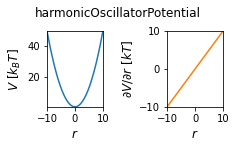

In [3]:
#Visualize
positions = np.linspace(-10,10, 100)
plot_1DPotential(pot, positions=positions)

## Stochastic Integrators

### Langevin Integrator

Here, we present the stochastic Langevin integrator for the numeric integration of our system. The Langevin integrator assumes that the system is coupled to a heat-bath. The interaction between the system and the heat-bath is modeled by a stochastic force term. 

The user has to set the step size $dt$ and the friction coefficient $gamma$. The start position of the particle is defined in the simulation setup later. The initial velocities are either calculated based on the previous position of the particle, thus the parameter $old\_position$ has to be set. If no $old\_position$ is set, the initial velocity will be randomly drawn from a Maxwell-Boltzmann distribution. The temperature of the simulation will be set during the system setup (see below).

In [4]:
#Simple Langevin integration simulation:
#Thermostat is already included (Langevin thermostat)

time_step = 0.2
start_position = 0
temperature = 15
space_range = [-10,10]

#integrator
sampler = langevinIntegrator(dt=time_step, gamma=15, old_position=0.01)

For our system we will use periodic boundary conditions. Therefore we specify `periodicBoundaryCondition()` and the corresponding range.

In [5]:
# periodic boundary conditions
pbc = periodicBoundaryCondition(boundary=[space_range])

We are now ready to perform the simulations. The system class wraps the integrator, the boundary conditions and the potential. Additionally, the initial position of the particle $position$ as well as the temperature parameter $temperature$ are set.

To start the simulation we define the number of steps and run `sys.simulate()`. The progress of the simulation is displayed by a progress bar.

In [6]:
#Simulation Setup
sys = system(potential=pot, sampler=sampler,  start_position=0,  temperature=temperature, conditions=[pbc])

#simulate
sim_steps = 2000
cur_state = sys.simulate(sim_steps, withdraw_traj=True, init_system=False)

Simulation:  Simulation: 100%|██████████| 2000/2000 [00:14<00:00, 140.11it/s]


After running the simulation, the simulation data can be displayed as a table using `sys.trajectory`. Note, that we used a position Langevin integrator that did not calculate the velocities explicitly. Therefore, the kinetic energy and velocity are not defined. If you want to calculate the velocities during the simulation use the `langevinVelocityIntegrator` instead.

In [7]:
print("Trajectory length: ",len(sys.trajectory))
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

Trajectory length:  2001

last_state:  State(position=array(-4.71563851), temperature=15, total_system_energy=11.118623293139938, total_potential_energy=11.118623293139938, total_kinetic_energy=nan, dhdpos=4.621118469040712, velocity=None)
2001


,position,temperature,total_system_energy,total_potential_energy,total_kinetic_energy,dhdpos,velocity
0,0,15.0,0.000191,0.000000,0.000191,0.000000,0.0195349
1,-0.4067594046046738,15.0,0.082727,0.082727,NaN,-0.000000,None
2,-0.7367111809260081,15.0,0.271372,0.271372,NaN,0.406759,None
3,-0.23585489259066722,15.0,0.027814,0.027814,NaN,0.736711,None
4,-1.375151177196958,15.0,0.945520,0.945520,NaN,0.235855,None


The simulation results can be visualized using the build-in visualizing tool `simulation_analysis_plot`. The left panel displays the energy surface as well as all visited states (orange dots). The start and end-state are colored in blue and red, respectively. The middle panel shows the probability density distribution of the simulation as well as a boxplot of the distribution. This plot can be used to check if the system was simulated successfully. The rightmost panel shows the development of the force over time. 
  

(<Figure size 602.656x150.664 with 3 Axes>, None)

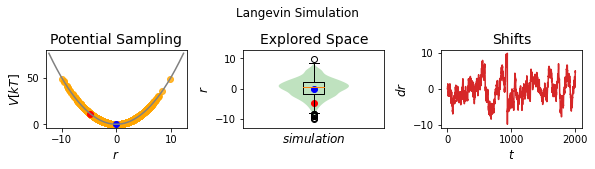

In [8]:
##visualize
simulation_analysis_plot(sys, title="Langevin Simulation")

The Ensembler package also contains a build-in functionality to make short movies of the simulation using `animation_trajectory`. 

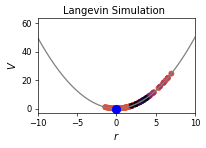

In [9]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Langevin Simulation")
ani


### MonteCarlo  Simulations

To make Ensembler as user-friendly as possible, only minimal changes are required to setup different simulations. The next simulation methods we look at are Monte Carlo Simulations. The setup of the simulation is identical to the Langevin simulation described above, except that a different sampler is used.

To perform a Monte Carlo Simulation, we need `monteCarloIntegrator()`. The Monte Carlo simulation performs a random displacement of the particle. The maximum magnitude of this displacement step can be set using the $step\_size\_coefficient$ parameter.

In [10]:
#Build System
sampler = monteCarloIntegrator(step_size_coefficient=2, space_range=[-10,10])
#periodic boundary conditions
pbc = periodicBoundaryCondition(boundary=[space_range])
sys = system(potential=pot, sampler=sampler,  start_position=0, conditions=[pbc])

#simulate
sim_steps = 2000
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))

sys.trajectory.head()

Simulation:  Simulation: 100%|██████████| 2000/2000 [00:12<00:00, 159.67it/s]


last_state:  State(position=array(-3.3), temperature=298.0, total_system_energy=5.444999999999907, total_potential_energy=5.444999999999907, total_kinetic_energy=nan, dhdpos=array(-6.49), velocity=nan)
2001


,position,temperature,total_system_energy,total_potential_energy,total_kinetic_energy,dhdpos,velocity
0,0,298.0,0.00000,0.00000,NaN,0,NaN
1,-0.71,298.0,0.25205,0.25205,NaN,-0.71,NaN
2,0.6400000000000001,298.0,0.20480,0.20480,NaN,1.35,NaN
3,9.99,298.0,49.90005,49.90005,NaN,9.35,NaN
4,9.18,298.0,42.13620,42.13620,NaN,-0.81,NaN


Again, the velocity and the kinetic energy are not defined. The visualization shows that the explored space does not resemble the respective Boltzmann-distribution of the system. This is because the Monte Carlo integrator samples independently of the energy of the system. To obtain the equilibrium Boltzmann-distribution one has to use the Metropolis criterion for accepting the Monte Carlo steps. This is explained below.

(<Figure size 602.656x150.664 with 3 Axes>, None)

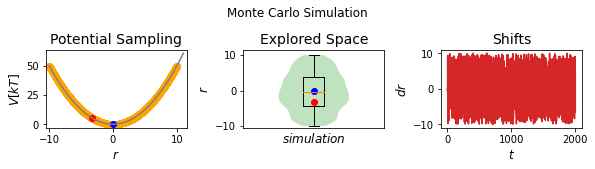

In [11]:
#visualize Simulation in Plot:
simulation_analysis_plot(sys, title="Monte Carlo Simulation", limits_coordinate_space=list(range(-10,11)))

Here, you can see the first steps in a short animation of the simulation. 

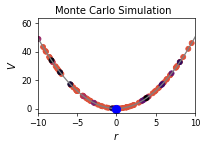

In [12]:
#Show Animation
animation, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Monte Carlo Simulation", every_n_frame=10)
animation

### Metropolis Monte Carlo

The Metropolis Monte Carlo integrator first performs a random displacement like the Monte Carlo integrator. However, if this step is accepted or rejected is decided based on an energy criterion. First, the energy difference $\Delta V$ between the proposed new and the last position is calculated. If the proposed new position has a smaller potential energy, then the step is always accepted. If the energy difference is positive, the step is accepted with the probability  $p=\exp(-{\frac {\Delta E}{kT}})$.

In [13]:
#super easy Metropolis_MonteCarlo simulation
sampler = metropolisMonteCarloIntegrator()
#periodic boundary conditions
pbc = periodicBoundaryCondition(boundary=[space_range])
sys = system(potential=pot, sampler=sampler,  start_position=9, conditions=[pbc])

#simulate
sim_steps = 2000
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

Simulation:  Simulation: 100%|██████████| 2000/2000 [00:12<00:00, 161.87it/s]


last_state:  State(position=array(3.91215085), temperature=298.0, total_system_energy=7.652462125769155, total_potential_energy=7.652462125769155, total_kinetic_energy=nan, dhdpos=array(2.47571398), velocity=nan)
2001


,position,temperature,total_system_energy,total_potential_energy,total_kinetic_energy,dhdpos,velocity
0,9,298.0,40.500000,40.500000,NaN,9,NaN
1,4.33763698664395,298.0,9.407547,9.407547,NaN,-4.66236301335605,NaN
2,1.9617092748068332,298.0,1.924152,1.924152,NaN,-2.375927711837117,NaN
3,-1.6842759042473086,298.0,1.418393,1.418393,NaN,-3.6459851790541418,NaN
4,0.030880276953062724,298.0,0.000477,0.000477,NaN,1.7151561812003713,NaN


Now, the explored space resembles the expected Boltzmann-distribution of the system. However, no kinetic information can be obtained from a Monte Carlo simulation. In cases where the kinetic information is of interest, we recommend to use the Langevin integrator.

(<Figure size 602.656x150.664 with 3 Axes>, None)

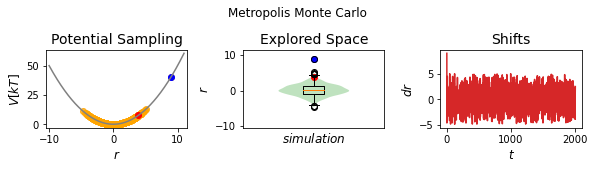

In [14]:
#plot
simulation_analysis_plot(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo")

Below you can see the first (accepted) steps in a short animation of the simulation. 

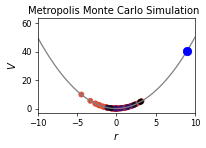

In [15]:
#plot
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Metropolis Monte Carlo Simulation", every_n_frame=10)
ani


## Optimizer - First order Methods

### Conjugated Gradient

A frequent task in molecular dynamics simulation is energy minimization or energy optimization. Ensembler also includes functionalities that support this task. One can specify `conjugate_gradient()` as the sampler. The simulation will then perform a conjugate gradient minimization.

In [16]:
#settings
sampler = conjugate_gradient()
sys = system(potential=pot, sampler=sampler,  start_position=9)

#simulate
sim_steps = 2000
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
print()
print("last_state: ", cur_state)
print(len(sys.trajectory))
sys.trajectory.head()

Simulation:  Simulation: 100%|██████████| 2000/2000 [00:05<00:00, 338.44it/s]


last_state:  State(position=0.0, temperature=298.0, total_system_energy=0.0, total_potential_energy=0.0, total_kinetic_energy=nan, dhdpos=0.0, velocity=nan)
2001


,position,temperature,total_system_energy,total_potential_energy,total_kinetic_energy,dhdpos,velocity
0,9,298.0,40.5,40.5,NaN,9.00,NaN
1,8,298.0,32.0,32.0,NaN,8.08,NaN
2,7,298.0,24.5,24.5,NaN,5.05,NaN
3,6,298.0,18.0,18.0,NaN,5.05,NaN
4,5,298.0,12.5,12.5,NaN,5.05,NaN


In the visualization we see that the particle quickly leaves its starting position at $x=9$ and moves energetically downhill. The particle finally resides at the energy minimum at $x=0$. Note, that this minimization algorithm only finds the nearest local minimum. It does not assure that the global optimum is found.

(<Figure size 602.656x150.664 with 3 Axes>, None)

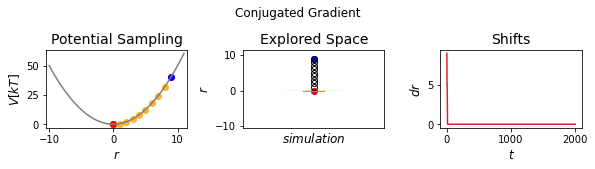

In [17]:
#plot
simulation_analysis_plot(sys, title="Conjugated Gradient", limits_coordinate_space=space_range)

The minimzation is animated below. 

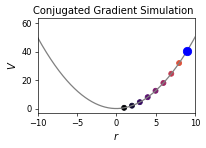

In [18]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Conjugated Gradient Simulation")
ani

## Newtonian Integrators - Second order Methods

### Position Verlet

The Position Verlet integrator is a non-stochastic integrator. The Verlet algorithm numerically integrates the Newton equation of motion. It provides good numerical stability and is time reversible as well as approximately energy conserving, all of which are important properties for molecular dynamics simulations. The Position Verlet integrator is used by calling `positionVerletIntegrator()` and defining the time step $dt$.

In [19]:
#Simulation Setup
sampler = positionVerletIntegrator(dt=0.1)
sys = system(potential=pot, sampler=sampler, start_position=-7.5)

#simulate
sim_steps = 2000
cur_state = sys.simulate(sim_steps, withdraw_traj=True, init_system=False)

sys.trajectory.head()

Simulation:  Simulation: 100%|██████████| 2000/2000 [00:04<00:00, 441.83it/s]


,position,temperature,total_system_energy,total_potential_energy,total_kinetic_energy,dhdpos,velocity
0,-7.500000,298.0,28.571855,28.125000,0.446855,-7.500000,-0.945363
1,-7.519536,298.0,28.290796,28.271713,0.019083,-7.500000,-0.195363
2,-7.463877,298.0,28.009628,27.854731,0.154897,-7.519536,0.556591
3,-7.333579,298.0,27.739569,26.890692,0.848877,-7.463877,1.302979
4,-7.129946,298.0,27.491396,25.418062,2.073334,-7.333579,2.036337


In this example, the particle is not coupled to a heat-bath. Therefore, this simulation conservers the total energy (NVE simulation) rather than the temperature (NVT simulation). This can be confirmed by the visualization. In contrast to the stochastic methods above we do not obtain the Boltzmann distribution.

(<Figure size 602.656x150.664 with 3 Axes>, None)

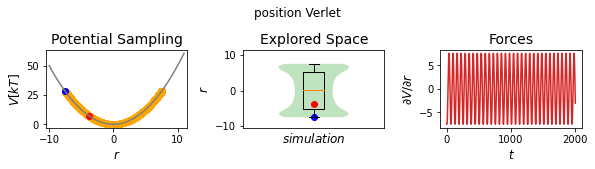

In [20]:
#plot
simulation_analysis_plot(sys, title="position Verlet", limits_coordinate_space=space_range)

Below you can see the first steps in a short animation of the simulation. 

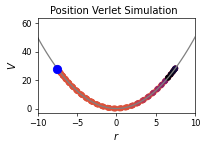

In [21]:
#animation
ani, out_path = animation_trajectory(sys, limits_coordinate_space=space_range, title="Position Verlet Simulation")
ani

## TwoD potentials

The above mentioned integrator types can be easily used to simulate 2D systems, too.

In [22]:
# Imports:
import os, sys
my_path = os.getcwd()+"/.."
print(my_path)
sys.path.append(my_path)

import numpy as np
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline


#Ensembler
##COde
from ensembler.potentials.TwoD import wavePotential
from ensembler.samplers.stochastic import monteCarloIntegrator, metropolisMonteCarloIntegrator, langevinIntegrator
from ensembler.samplers.newtonian import positionVerletIntegrator, leapFrogIntegrator
from ensembler.conditions.box_conditions import periodicBoundaryCondition

from ensembler.system import system

##Visualisation
from ensembler.visualisation import plotPotentials
from ensembler.visualisation.plotSimulations import simulation_analysis_plot


/Users/stlinker/Desktop/phD/Riniker/Github/Ensembler/examples/..


### Lagevin

To define the 2D potential, we use the two dimensional `wavePotential()` function. We specify the $multiplicity$, which defines the number of minima in one phase (-180 to 180 degree) in x- and y-direction. Due to the modular architecture of Ensembler, only minimal changes in respect to the 1D case are required. In fact, only the parameters that specify a phases-space point, i.e. $old\_position$ and $start\_position$ need to be adapted from 1D to 2D points. 

The visualization automatically adapts to the dimensionality of the system.

Simulation:  Simulation: 100%|██████████| 2000/2000 [00:14<00:00, 133.98it/s]


(<Figure size 1152x288 with 5 Axes>, None)

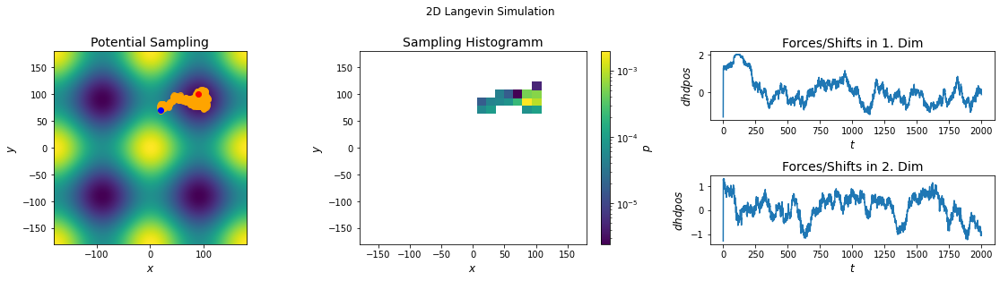

In [23]:
#settings
sim_steps=1000
space_range=[[-180, 180], [-180, 180]]

pbc = periodicBoundaryCondition(boundary=space_range)
pot2D = wavePotential(multiplicity=[2,2])
sampler = langevinIntegrator(dt=1, gamma=10 , old_position=[20.01,70.01])
sys = system(potential=pot2D, sampler=sampler,  start_position=[20,70], temperature=5, conditions=[pbc])

#simulate
sim_steps = 2000
cur_state = sys.simulate(sim_steps, withdraw_traj=True)

#Plot
simulation_analysis_plot(system=sys, title=" 2D Langevin Simulation", limits_coordinate_space=space_range)

### Metropolis MonteCarlo

The same "minimal change policy" applies to Metropolis Monte Carlo simulations. 

Simulation:  Simulation: 100%|██████████| 2000/2000 [00:15<00:00, 130.29it/s]


(<Figure size 1152x288 with 5 Axes>, None)

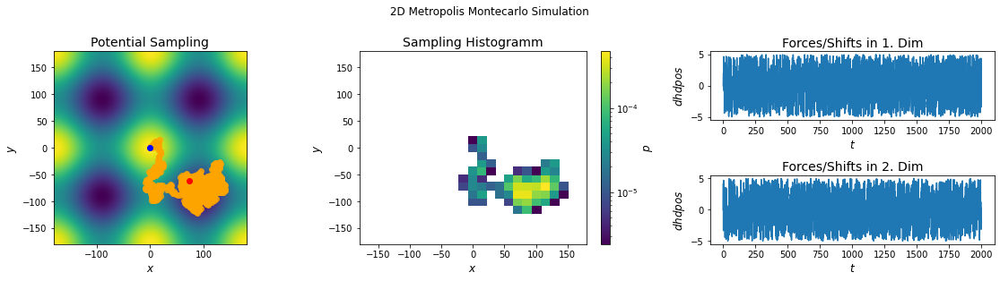

In [24]:
#settings
sim_steps=1000
space_range=[[-180, 180], [-180, 180]]

pbc = periodicBoundaryCondition(boundary=space_range)
pot2D = wavePotential(multiplicity=[2,2])
sampler = metropolisMonteCarloIntegrator(step_size_coefficient=5) # the maximal step for one MCM step can be  -+5 degree
sys = system(potential=pot2D, sampler=sampler,  conditions=[pbc], start_position=[0,0])

#simulate
sim_steps = 2000
cur_state = sys.simulate(sim_steps, withdraw_traj=True)
simulation_analysis_plot(system=sys, title=" 2D Metropolis Montecarlo Simulation", limits_coordinate_space=space_range)

### Newtonian Simulation

As already shown for the previous examples, the integrator class is very flexible and can adapt to any kind of potential function or dimensionality.

Simulation:  Simulation: 100%|██████████| 2000/2000 [00:14<00:00, 140.46it/s]


(<Figure size 1152x288 with 5 Axes>, None)

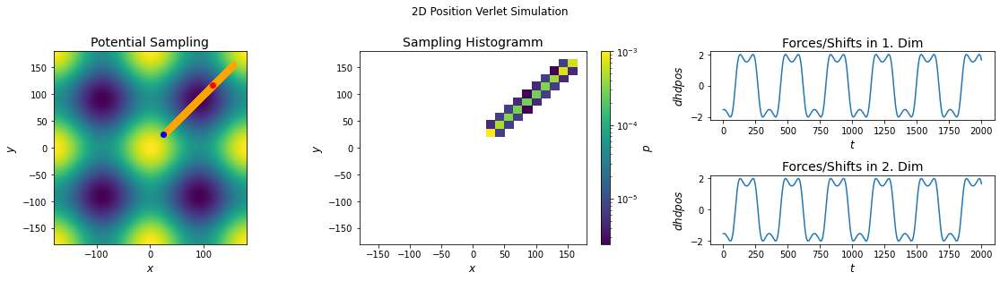

In [25]:
#settings
space_range = [[-180, 180], [-180, 180]]
sim_steps = 1000

pbc = periodicBoundaryCondition(boundary=space_range)
pot2D = wavePotential(multiplicity=[2,2])
sampler = positionVerletIntegrator(dt=0.1)

sys = system(potential=pot2D, sampler=sampler,  start_position=[25,25], conditions=[pbc])

#simulate
sim_steps = 2000
cur_state = sys.simulate(sim_steps, withdraw_traj=True) 

simulation_analysis_plot(system=sys, title=" 2D Position Verlet Simulation", limits_coordinate_space=space_range)


This is the end of our Simulation Example notebook. We hope the reader has now a clearer understanding how Ensembler works and how different integration methods can be used. 

Feedback is appreciated in our gitlab repository or directly to [@linkerst](https://https://github.com/linkerst).